### Import Libs

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.graph_objects as go
import seaborn as sns
from plotly.subplots import make_subplots
from datetime import timedelta
from math import ceil
from copy import deepcopy

### Read and format data

In [2]:
PATH_PART_2 = '../data/part 2'

In [3]:
df_assets = pd.read_csv(PATH_PART_2+'/assets.csv')
df_assets.head()

,_id,company,createdAt,description,model,modelType,name,sensors,specifications.axisX,specifications.axisY,specifications.axisZ,specifications.maxDowntime,specifications.maxTemp,specifications.power,specifications.rpm,specifications.workdays
0,602fac7228aba1048d473cc4,5fb2c4eb1369a4325dc4545f,2021-02-19T12:17:54.457Z,NaN,60241102ed8ef30e9d309af9,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,"[""IAJ9206""]",vertical,horizontal,axial,48.00,NaN,3.7,1735.0,NaN
1,5fd0e297bf7d581c1823b8e4,5fbbadeb82a6b901c26df618,2020-12-09T14:43:35.168Z,NaN,5fd0cf96bf7d581c1823b4c4,heaterFurnace,RDF-61.1,"[""LZY4270""]",axial,vertical,horizontal,0.25,55.0,0.0,1740.0,NaN
2,5fb286de1369a4325dc45433,5f6b83e34dd69d4bc799ea1f,2020-11-16T14:04:14.564Z,-,5fb275981369a4325dc4542e,transformer,TRANSFORMADOR 500 KVA N°1,"[""MUR8453""]",horizontal,vertical,NaN,NaN,65.0,NaN,NaN,NaN
3,6023fad9ed8ef30e9d30952b,5fb2c4eb1369a4325dc4545f,2021-02-10T15:25:13.265Z,NaN,6023f7dced8ef30e9d30945f,pump,Motor Bomba - Tanque de Expansão Tubo Verde,"[""MXK6435""]",horizontal,axial,vertical,48.00,NaN,7.0,3525.0,NaN
4,5ff71a150b6abb7be05083b0,5f17203f640a00cc08cb1b3d,2021-01-07T14:26:29.726Z,NaN,5ff5a854adacd8372cf06950,pump,CAG1- BAGS.12- Motor,"[""MYD8706""]",horizontal,axial,vertical,NaN,NaN,30.0,1765.0,NaN


In [4]:
df_assets['sensors'] = df_assets['sensors'].apply(lambda x:x[2:-2])

In [5]:
df_assets.fillna('Não informado', inplace=True)

C:\Users\anton\AppData\Local\Temp\ipykernel_7176\273278783.py:1: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Não informado' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df_assets.fillna('Não informado', inplace=True)


In [6]:
df_assets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   _id                         10 non-null     object
 1   company                     10 non-null     object
 2   createdAt                   10 non-null     object
 3   description                 10 non-null     object
 4   model                       10 non-null     object
 5   modelType                   10 non-null     object
 6   name                        10 non-null     object
 7   sensors                     10 non-null     object
 8   specifications.axisX        10 non-null     object
 9   specifications.axisY        10 non-null     object
 10  specifications.axisZ        10 non-null     object
 11  specifications.maxDowntime  10 non-null     object
 12  specifications.maxTemp      10 non-null     object
 13  specifications.power        10 non-null     object
 1

In [7]:
df_collects = pd.read_csv(PATH_PART_2+'/collects.csv')
df_collects.head(10)

,_id,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.sampRate,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp
0,60b57955f77013684c413e39,2021-06-01T00:03:33.370Z,0.010463,0.004463,0.011677,3.006,1656.686627,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94
1,60b57c53f77013684c41409f,2021-06-01T00:16:19.173Z,0.011437,0.004983,0.011482,3.006,1656.686627,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19
2,60b57f34f77013684c4142cd,2021-06-01T00:28:36.553Z,0.010494,0.005024,0.011120,3.006,1656.686627,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50
3,60b58237f77013684c41450c,2021-06-01T00:41:27.622Z,0.009859,0.004786,0.011096,3.006,1656.686627,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87
4,60b58515f77013684c414765,2021-06-01T00:53:41.450Z,0.010014,0.005213,0.011332,3.006,1656.686627,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56
5,60b587f2f77013684c414987,2021-06-01T01:05:54.307Z,0.010951,0.004751,0.011504,3.006,1656.686627,1.622510e+09,0.000580,0.000230,0.000304,IAJ9206,21.81
6,60b58ad6f77013684c414be4,2021-06-01T01:18:14.468Z,0.011001,0.004790,0.011696,3.006,1656.686627,1.622510e+09,0.000593,0.000222,0.000306,IAJ9206,21.87
7,60b58dc1f77013684c414e42,2021-06-01T01:30:41.688Z,0.010492,0.005010,0.011517,3.006,1656.686627,1.622511e+09,0.000556,0.000238,0.000282,IAJ9206,21.50
8,60b590bdf77013684c4150a1,2021-06-01T01:43:25.520Z,0.010417,0.004966,0.011568,3.006,1656.686627,1.622512e+09,0.000519,0.000220,0.000258,IAJ9206,21.37
9,60b593aaf77013684c4152f4,2021-06-01T01:55:54.302Z,0.010061,0.005315,0.011435,3.006,1656.686627,1.622513e+09,0.000487,0.000255,0.000286,IAJ9206,21.19


In [8]:
df_collects.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33901 entries, 0 to 33900
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   _id                33901 non-null  object 
 1   createdAt          33901 non-null  object 
 2   params.accelRMS.x  33441 non-null  float64
 3   params.accelRMS.y  33441 non-null  float64
 4   params.accelRMS.z  33441 non-null  float64
 5   params.duration    33441 non-null  float64
 6   params.sampRate    33441 non-null  float64
 7   params.timeStart   33441 non-null  float64
 8   params.velRMS.x    33441 non-null  float64
 9   params.velRMS.y    33441 non-null  float64
 10  params.velRMS.z    33441 non-null  float64
 11  sensorId           33901 non-null  object 
 12  temp               33901 non-null  float64
dtypes: float64(10), object(3)
memory usage: 3.4+ MB


In [9]:
df_collects['createdAt'] = pd.to_datetime(df_collects['createdAt'])
df_collects = df_collects.sort_values(by=['sensorId', 'createdAt'])
df_collects.set_index('createdAt', inplace=True)

In [10]:
df_collects.head()

,_id,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.sampRate,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp
createdAt,,,,,,,,,,,,
2021-06-01 00:03:33.370000+00:00,60b57955f77013684c413e39,0.010463,0.004463,0.011677,3.006,1656.686627,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94
2021-06-01 00:16:19.173000+00:00,60b57c53f77013684c41409f,0.011437,0.004983,0.011482,3.006,1656.686627,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19
2021-06-01 00:28:36.553000+00:00,60b57f34f77013684c4142cd,0.010494,0.005024,0.011120,3.006,1656.686627,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50
2021-06-01 00:41:27.622000+00:00,60b58237f77013684c41450c,0.009859,0.004786,0.011096,3.006,1656.686627,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87
2021-06-01 00:53:41.450000+00:00,60b58515f77013684c414765,0.010014,0.005213,0.011332,3.006,1656.686627,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56


### Data visualization

In [11]:
df_collects['sensorId'].unique()

array(['IAJ9206', 'LZY4270', 'MUR8453', 'MXK6435', 'MYD8706', 'MYS2071',
       'MZU6388', 'NAH4736', 'NAI1549', 'NEW4797'], dtype=object)

In [12]:
not_sensors = ['params.duration', 'params.sampRate', 'params.timeStart']
sensor_columns = df_collects.select_dtypes(include=np.number).columns.tolist()
sensor_columns = [columns for columns in sensor_columns if columns not in not_sensors]

In [13]:
def plot_asset_info(df:pd.DataFrame, sensor:str):
    
    asset = df_assets[df_assets['sensors']==sensor]['name'].values[0]
    model_type = df_assets[df_assets['sensors']==sensor]['modelType'].values[0]
    power = df_assets[df_assets['sensors']==sensor]['specifications.power'].values[0]
    rpm = df_assets[df_assets['sensors']==sensor]['specifications.rpm'].values[0]
    max_temp = df_assets[df_assets['sensors']==sensor]['specifications.maxTemp'].values[0]
    max_downtime = df_assets[df_assets['sensors']==sensor]['specifications.maxDowntime'].values[0]
    
    num_rows = len(sensor_columns)
    fig = make_subplots(rows=num_rows, cols=1,  subplot_titles=[column for column in sensor_columns], vertical_spacing=0.3/num_rows)

    for i, column in enumerate(sensor_columns):  
        fig.add_trace(go.Scatter(x=df.index, 
                                 y=df[column], 
                                 mode='lines',
                                 line={
                                     'width':1.75
                                 }), row=i+1, col=1)

        fig.update_xaxes(title_text='Time', row=i+1, col=1)
        fig.update_yaxes(title_text=column, row=i+1, col=1)

    fig.update_layout(
        title=f"""
                Ativo: {asset} <br>Sensor: {sensor}<br>Tipo: {model_type}<br>Potência: {power}<br>RPM: {rpm}<br>Temperatura máxima: {max_temp}<br>Tempo de downtime: {max_downtime}
               """,
        height=400*num_rows+400,
        width=1400,
        margin=dict(t=250),
        showlegend=False
    )
    fig.update_layout(
        title=dict(y=0.98,  xanchor='left', yanchor='top'))
    fig.show()

In [14]:
for sensor in df_collects['sensorId'].unique():
    df = df_collects[df_collects['sensorId']==sensor]
    plot_asset_info(df, sensor)

### Uptime and downtime

I chose the sensor MYD8706 for this analysis

In [15]:
sensor = 'MYD8706'
df = df_collects[df_collects['sensorId']==sensor]
df = df[sensor_columns]
df.isna().sum()

params.accelRMS.x    64
params.accelRMS.y    64
params.accelRMS.z    64
params.velRMS.x      64
params.velRMS.y      64
params.velRMS.z      64
temp                  0
dtype: int64

In [16]:
df = df.interpolate()
df.isna().sum()

params.accelRMS.x    0
params.accelRMS.y    0
params.accelRMS.z    0
params.velRMS.x      0
params.velRMS.y      0
params.velRMS.z      0
temp                 0
dtype: int64

In [17]:
plot_asset_info(df, sensor)

In [18]:
df.describe()

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z,temp
count,4354.000000,4354.000000,4354.000000,4354.000000,4354.000000,4354.000000,4354.000000
mean,0.107181,0.083955,0.091677,0.001530,0.001265,0.000884,23.424421
std,0.119075,0.096034,0.093721,0.001523,0.001355,0.000520,6.152071
min,0.008405,0.004325,0.013520,0.000171,0.000091,0.000287,9.750000
25%,0.009133,0.004882,0.015020,0.000292,0.000157,0.000458,18.190000
50%,0.009225,0.004990,0.015466,0.000299,0.000161,0.000469,23.690000
75%,0.245668,0.197085,0.201656,0.003301,0.002876,0.001485,27.870000
max,0.321101,0.229714,0.259092,0.012329,0.004618,0.001806,41.940000


In [19]:
def plot_distribution(df, n_cols=4, hue=None):
        
    n_rows = int(ceil(df.shape[1]/n_cols))
    fig = plt.figure(figsize=(16, n_rows*4))
    for idx, column in enumerate(df.columns):
        ax = plt.subplot(n_rows, n_cols, idx+1)
        sns.kdeplot(data=df, x=column, fill=True, common_norm=True, ax=ax, hue=hue)
        ax.set_title(column)
        ax.grid()
        
    fig.tight_layout()
    plt.show()

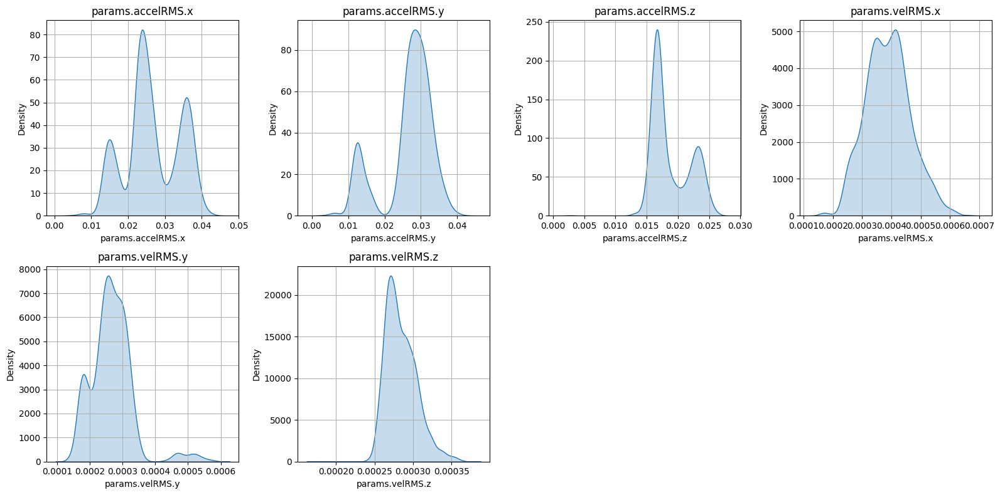

In [90]:
plot_distribution(df)

As we can see, there is a clear difference of behavior of this asset, representing the downtime and uptime.

In [21]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, dbscan
from sklearn.metrics import silhouette_score

In [22]:
scaler = StandardScaler()
X = scaler.fit_transform(df)

In [23]:
kmeans_model = KMeans(n_clusters=2)
labels = kmeans_model.fit_predict(X)

In [24]:
df['label'] = labels

In [25]:
df['label'].value_counts()

label
0    2603
1    1751
Name: count, dtype: int64

In [26]:
aux_column = df.columns[0] # Get info of a column
labels_list = df['label'].unique()
mean_list = []
for label in df['label'].unique():
    mean = df[df['label']==label][aux_column].mean()
    mean_list.append(mean)

uptime_label = labels_list[np.argmax(mean_list)]
downtime_label = labels_list[np.argmin(mean_list)]

In [27]:
def plot_clustering_result(df:pd.DataFrame, sensor:str):
    
    num_rows = len(sensor_columns)
    fig = make_subplots(rows=num_rows, cols=1,  subplot_titles=[column for column in sensor_columns], vertical_spacing=0.3/num_rows)
    
    df_uptime = deepcopy(df)
    df_downtime = deepcopy(df)
    df_uptime.loc[df_uptime['label']==downtime_label , sensor_columns] = np.nan
    df_downtime.loc[df_downtime['label']==uptime_label , sensor_columns] = np.nan

    for i, column in enumerate(sensor_columns):  
        
        fig.add_trace(go.Scatter(x=df_downtime.index,
                                 y=df_downtime[column],
                                 mode='lines+markers',
                                 name = 'downtime',
                                 legendgroup=i,
                                 marker={
                                     'color':'red',
                                     'size':4.5
                                 },
                                 ), row=i+1, col=1)
        fig.add_trace(go.Scatter(x=df_uptime.index,
                                 y=df_uptime[column],
                                 mode='lines+markers',
                                 name = 'uptime',
                                 legendgroup=i,
                                 marker={
                                     'color':'green',
                                     'size':4.5
                                 },
                                 ), row=i+1, col=1)

        fig.update_xaxes(title_text='Time', row=i+1, col=1)
        fig.update_yaxes(title_text=column, row=i+1, col=1)
        fig.update_layout(showlegend=True)

    fig.update_layout(
        title=sensor,
        height=400*num_rows,
        width=1600,
        legend_tracegroupgap = 350
    )
    fig.show()

In [28]:
plot_clustering_result(df, sensor)

C:\Users\anton\AppData\Local\Temp\ipykernel_7176\3824319794.py:7: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



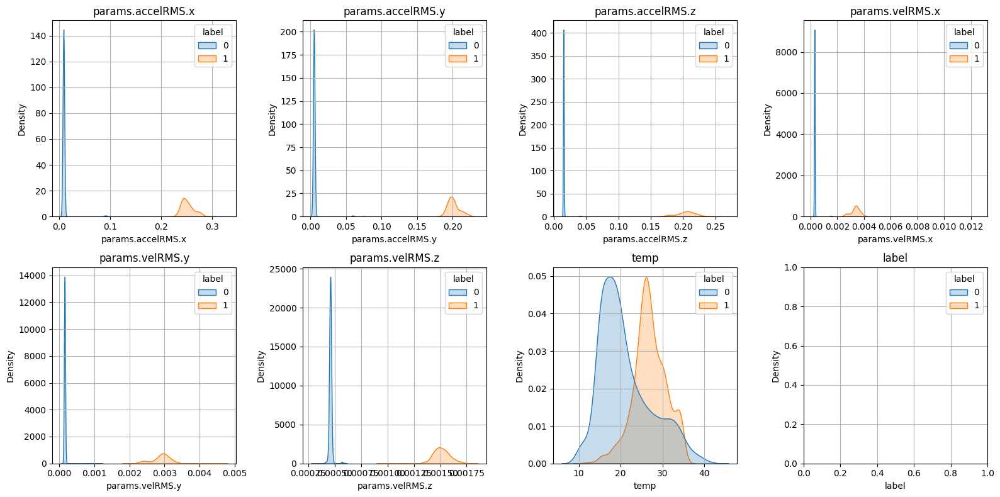

In [29]:
plot_distribution(df, hue='label')

In [30]:
df_aux = deepcopy(df)
df_aux['aux'] = (df_aux['label'].diff() != 0).astype('int').cumsum()
df_aux['date'] = df_aux.index

df_down_up_time = pd.DataFrame({'start_date' : df_aux.groupby('aux')['date'].min(), 
                                'final_date' : df_aux.groupby('aux')['date'].max(),
                                'consecutive_calues' : df_aux.groupby('aux').size(), 
                                'label':df_aux.groupby('aux')['label'].first()
                                }).reset_index(drop=True)
df_down_up_time.head()

,start_date,final_date,consecutive_calues,label
0,2021-06-01 00:07:16.967000+00:00,2021-06-01 12:48:37.713000+00:00,65,0
1,2021-06-01 13:00:20.660000+00:00,2021-06-02 00:20:04.950000+00:00,58,1
2,2021-06-02 00:32:04.585000+00:00,2021-06-02 12:25:30.212000+00:00,61,0
3,2021-06-02 12:37:44.633000+00:00,2021-06-03 00:07:00.573000+00:00,59,1
4,2021-06-03 00:19:01.484000+00:00,2021-06-03 13:00:36.322000+00:00,65,0


In [31]:
# Calculate duration of interval in hours
df_down_up_time['duration'] = (df_down_up_time['final_date'] - df_down_up_time['start_date']).apply(lambda x:round(x.total_seconds()/3600,3))
df_down_up_time.head()

,start_date,final_date,consecutive_calues,label,duration
0,2021-06-01 00:07:16.967000+00:00,2021-06-01 12:48:37.713000+00:00,65,0,12.689
1,2021-06-01 13:00:20.660000+00:00,2021-06-02 00:20:04.950000+00:00,58,1,11.329
2,2021-06-02 00:32:04.585000+00:00,2021-06-02 12:25:30.212000+00:00,61,0,11.890
3,2021-06-02 12:37:44.633000+00:00,2021-06-03 00:07:00.573000+00:00,59,1,11.488
4,2021-06-03 00:19:01.484000+00:00,2021-06-03 13:00:36.322000+00:00,65,0,12.693


In [32]:
uptime = df_down_up_time[df_down_up_time['label']==uptime_label]['duration'].sum()
downtime = df_down_up_time[df_down_up_time['label']==downtime_label]['duration'].sum()

In [33]:
print(f'The uptime of this asset is: {round(uptime,2)} hours')
print(f'The downtime of this asset is: {round(downtime,2)} hours')

The uptime of this asset is: 341.14 hours
The downtime of this asset is: 509.58 hours


### Identify frequency patterns

In [34]:
def apply_fft(series:pd.Series):
    
    N = len(series)
    T = (series.index[1] - series.index[0]).total_seconds()
    freq = np.fft.fftfreq(N, T)
    fft = np.abs(np.fft.fft(series))/N
    mask = freq > 0 

    return freq[mask], fft[mask]

In [35]:
def apply_fft_wind_zeropad(series:pd.Series):

  N = len(series)
  T = (series.index[1] - series.index[0]).total_seconds()
  # Create hanning window to reduce spectral leakage 
  w = np.hanning(N)
  # Applying a fft with 10x zero padding
  fft = np.abs(np.fft.fft(series*w, len(series)*10))/N
  freq = np.fft.fftfreq(N*10, T)
  mask = freq > 0 
  
  return freq[mask], fft[mask]

In [36]:
def resample_data(df:pd.DataFrame, sample_rate:int) -> pd.DataFrame:

    start_date = df.index[0].round(freq=f'{sample_rate}min')
    final_date = df.index[-1].round(freq=f'{sample_rate}min')
    new_index = pd.date_range(start_date, final_date, freq=f'{sample_rate}min')
    df_resample = (df
     .reindex(df.index.union(new_index))
     .interpolate(method='time')
     .reindex(new_index)
     .dropna(axis=0)
    )
    return df_resample

In [37]:
def calculate_sampling_info(df:pd.DataFrame) -> pd.Series:
    delta_time_list = []
    for i in range(1,df.shape[0]):
        delta_time = (df.index[i]-df.index[i-1]).total_seconds()/60 # delta time in minutes
        delta_time_list.append(delta_time)

    return pd.Series(delta_time_list).describe()

In [38]:
for sensor in df_collects['sensorId'].unique():
    sensor_columns = [sensor for sensor in sensor_columns if sensor != 'temp']
    df = df_collects[df_collects['sensorId']==sensor]
    df = df[sensor_columns]

    sample_rate = 10 # minutes
    df_resample = resample_data(df, sample_rate)

    num_rows = df_resample.shape[1]
    fig = make_subplots(rows=num_rows, cols=1,  subplot_titles=[f"{col}" for col in df_resample.columns])
    for i, column in enumerate(df_resample.columns):
        freq, fft = apply_fft(df_resample[column])  
        fig.add_trace(go.Scatter(x=freq, y=fft, mode='lines'), row=i+1, col=1)
        fig.update_xaxes(title_text='Frequency [Hz]', row=i+1, col=1)
        fig.update_yaxes(title_text='Spectrum', row=i+1, col=1)
    
    fig.update_layout(
        title=sensor,
        height=300*num_rows,
        width=1000,
        showlegend=False
    )
    fig.show()

The asset of the sensor IAJ9206 was chosen for this analysis

In [421]:
sensor_columns += ['temp']

In [422]:
sensor = 'NEW4797'
n_clusters = 3
df = df_collects[df_collects['sensorId']==sensor]
# sensor_columns = [sensor for sensor in sensor_columns if sensor != 'temp']
df = df[sensor_columns]

In [423]:
calculate_sampling_info(df)

count    2248.000000
mean       23.088702
std        25.443842
min        11.635783
25%        16.847912
50%        17.096325
75%        18.207275
max       802.399733
dtype: float64

In [424]:
features_dict = {
    'mean': lambda x:np.mean(x),
    'median': lambda x:np.median(x),
    'std': lambda x:np.std(x),
    'max': lambda x:np.max(x),
    'min': lambda x:np.min(x),
    'max_amplitude': lambda x:apply_fft_wind_zeropad(x)[1].max(),
    'sum_amplitude': lambda x:apply_fft_wind_zeropad(x)[1].sum(),
    'mean_amplitude': lambda x:apply_fft_wind_zeropad(x)[1].mean(),
    'std_amplitude': lambda x:apply_fft_wind_zeropad(x)[1].std(),
    'max_product': lambda x:(apply_fft_wind_zeropad(x)[0]*apply_fft_wind_zeropad(x)[1]).max(),
    'sum_product': lambda x:(apply_fft_wind_zeropad(x)[0]*apply_fft_wind_zeropad(x)[1]).sum(),
    'mean_product': lambda x:(apply_fft_wind_zeropad(x)[0]*apply_fft_wind_zeropad(x)[1]).mean(),
    'std_product': lambda x:(apply_fft_wind_zeropad(x)[0]*apply_fft_wind_zeropad(x)[1]).std(),
    'max_power': lambda x:(apply_fft_wind_zeropad(x)[1]**2).max(),
    'sum_power': lambda x:(apply_fft_wind_zeropad(x)[1]**2).sum(),
    'mean_power': lambda x:(apply_fft_wind_zeropad(x)[1]**2).mean(),
    'std_power': lambda x:(apply_fft_wind_zeropad(x)[1]**2).std(),
}

In [425]:
def feature_engineering(df:pd.DataFrame, features_dict:dict, window_size_minutes:int, step_size_minutes:int, sample_rate:int=10) -> pd.DataFrame:

    df_features = pd.DataFrame()
    window = int(window_size_minutes/sample_rate)
    step = int(step_size_minutes/sample_rate)
    for feat_name, feat in features_dict.items():
        df_feat = df.rolling(window, step=step, center=True).apply(feat)
        df_feat.dropna(axis=0, inplace=True)
        df_feat.columns = [f'{feat_name}_{column}' for column in df.columns]
        df_features = pd.concat([df_features, df_feat], axis=1)
    
    return df_features

In [426]:
sample_rate = 10 #minutes
df_resample = resample_data(df, sample_rate)

In [427]:
window_size_minutes = 120
step_size_minutes = 120

In [428]:
df_features = feature_engineering(
    df = df_resample, 
    features_dict = features_dict,
    window_size_minutes = window_size_minutes, 
    step_size_minutes = step_size_minutes)

In [429]:
df_features.head()

,mean_params.accelRMS.x,mean_params.accelRMS.y,mean_params.accelRMS.z,mean_params.velRMS.x,mean_params.velRMS.y,mean_params.velRMS.z,mean_temp,median_params.accelRMS.x,median_params.accelRMS.y,median_params.accelRMS.z,...,mean_power_params.velRMS.y,mean_power_params.velRMS.z,mean_power_temp,std_power_params.accelRMS.x,std_power_params.accelRMS.y,std_power_params.accelRMS.z,std_power_params.velRMS.x,std_power_params.velRMS.y,std_power_params.velRMS.z,std_power_temp
2021-06-01 02:10:00+00:00,0.036510,0.090462,0.050416,0.000606,0.001400,0.000842,58.000831,0.035279,0.084429,0.047507,...,5.326391e-08,2.002492e-08,92.373741,0.000061,0.000327,0.000115,1.805272e-08,8.718174e-08,3.491240e-08,194.038031
2021-06-01 04:10:00+00:00,0.035495,0.087072,0.047999,0.000569,0.001364,0.000746,57.409081,0.042228,0.111420,0.062170,...,6.565919e-08,1.787026e-08,90.078732,0.000072,0.000450,0.000132,1.793600e-08,1.066127e-07,3.231734e-08,189.128220
2021-06-01 06:10:00+00:00,0.039215,0.091337,0.053278,0.000647,0.001466,0.000836,55.908636,0.044717,0.107437,0.061911,...,8.722978e-08,2.502677e-08,83.989228,0.000111,0.000671,0.000221,2.795294e-08,1.752983e-07,5.118240e-08,176.559795
2021-06-01 08:10:00+00:00,0.034236,0.061280,0.037042,0.000526,0.000865,0.000589,53.065879,0.015916,0.014766,0.014125,...,1.178569e-08,6.663475e-09,75.030982,0.000037,0.000086,0.000040,9.876868e-09,1.871408e-08,1.293874e-08,158.149303
2021-06-01 10:10:00+00:00,0.030400,0.065014,0.036641,0.000509,0.001006,0.000657,55.246029,0.023131,0.043254,0.027260,...,4.852306e-08,1.383359e-08,86.518330,0.000059,0.000314,0.000085,1.516010e-08,6.600998e-08,2.370298e-08,180.659037


In [430]:
corr_matrix = df_features.corr()

In [431]:
def find_redundant_features(df:pd.DataFrame, threshold:float=0.8) -> list:

    redundant_set = set()
    corr_matrix = df.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (abs(corr_matrix.iloc[i,j]) >= threshold):
                colname = corr_matrix.columns[i]
                redundant_set.add(colname)
    return list(redundant_set)

In [459]:
redundant_features = find_redundant_features(df_features, threshold=0.9)
len(redundant_features)

113

In [460]:
df_selected = df_features.drop(redundant_features, axis=1)

In [461]:
df_selected.head()

,mean_params.accelRMS.x,mean_temp,std_params.accelRMS.x,std_temp,max_params.accelRMS.x,min_params.accelRMS.x
2021-06-01 02:10:00+00:00,0.036510,58.000831,0.012664,1.045424,0.055698,0.018153
2021-06-01 04:10:00+00:00,0.035495,57.409081,0.013863,1.449313,0.052262,0.016465
2021-06-01 06:10:00+00:00,0.039215,55.908636,0.012541,0.687612,0.055462,0.014180
2021-06-01 08:10:00+00:00,0.034236,53.065879,0.029913,1.011510,0.096372,0.006321
2021-06-01 10:10:00+00:00,0.030400,55.246029,0.015852,1.101846,0.063317,0.016247


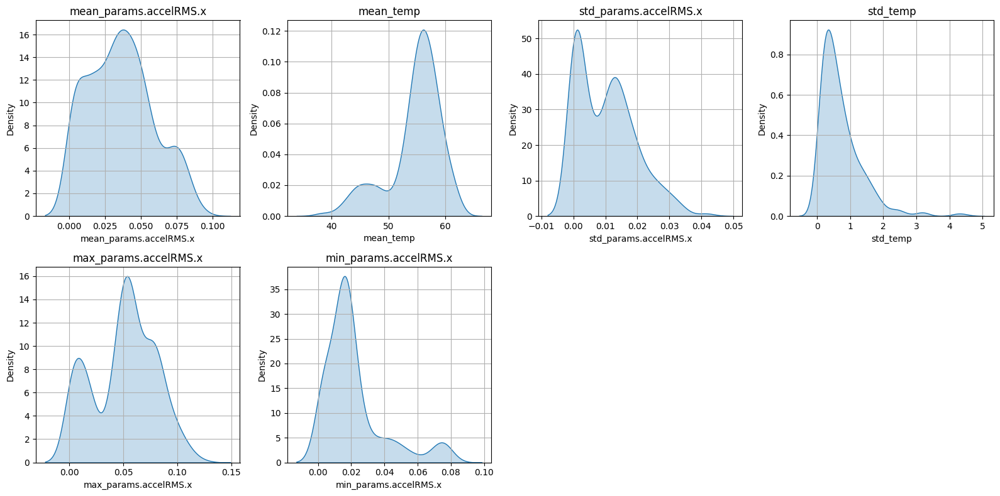

In [462]:
plot_distribution(df_selected)

In [463]:
scaler = StandardScaler()
X = scaler.fit_transform(df_selected)

In [464]:
kmeans_model = KMeans(n_clusters=n_clusters)
labels = kmeans_model.fit_predict(X)

In [465]:
df_selected['label'] = labels

In [466]:
df_selected['label'].value_counts()

label
1    242
0    119
2     71
Name: count, dtype: int64

C:\Users\anton\AppData\Local\Temp\ipykernel_7176\3824319794.py:7: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



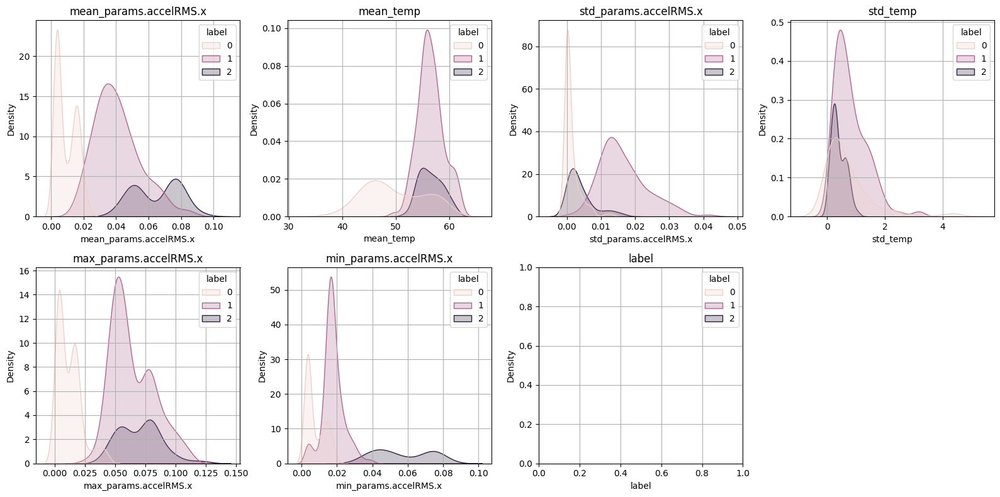

In [467]:
plot_distribution(df_selected, hue='label')

In [468]:
def add_classification_info(df:pd.DataFrame, df_selected:pd.DataFrame, sample_rate:int=10) -> pd.DataFrame:
    df_copy = deepcopy(df)
    for idx, label in zip(df_selected.index, df_selected['label']):
        start_date = idx - timedelta(minutes=window_size_minutes/2)
        final_date = idx + timedelta(minutes=window_size_minutes/2 - sample_rate)
        df_copy.loc[start_date:final_date, 'label'] = label
    
    return df_copy.bfill().ffill()


In [469]:
df_final = add_classification_info(df_resample, df_selected, sample_rate)

In [489]:
def plot_freq_clustering_result(df:pd.DataFrame, sensor:str, cluster_dict:dict={}, cluster_colors_dict:dict={}):
    
    num_rows = len(sensor_columns)
    fig = make_subplots(rows=num_rows, cols=1,  subplot_titles=[column for column in sensor_columns], vertical_spacing=0.3/num_rows)
    conditions = df['label'].unique()

    colors = ['green','red','blue']
    
    for i, column in enumerate(sensor_columns):  
        for condition in conditions:
            
            df_aux = deepcopy(df)
            df_aux.loc[df_aux['label']!=condition , sensor_columns] = np.nan
            name = cluster_dict.get(condition, condition)
            color = cluster_colors_dict.get(name, colors[int(condition)])
            
            fig.add_trace(go.Scatter(x=df_aux.index,
                                     y=df_aux[column],
                                     mode='lines+markers',
                                     name = name,
                                     legendgroup=i,
                                     marker={
                                         'color':color
                                     }
                                     ), row=i+1, col=1)


        fig.update_xaxes(title_text='Time', row=i+1, col=1)
        fig.update_yaxes(title_text=column, row=i+1, col=1)
        fig.update_layout(showlegend=True)

    fig.update_layout(
        title=sensor,
        height=400*num_rows,
        width=1600,
        legend_tracegroupgap = 350
    )
    fig.show()

In [490]:
plot_freq_clustering_result(df_final, sensor)

As we can see in the distplot, the feature "mean_params.accelRMS.x" has a well separated distribution according to the condition of the asset, and by the nature of the sensor and the feature, higher values indicate worst working conditions, so I will use it to classify the clusters.

In [482]:
explicability_col = 'mean_params.accelRMS.x'
explicability_values_by_condition = []
conditions_text = ['downtime', 'normal', 'failure'] 
conditions = df_selected['label'].unique().tolist()

for condition in conditions:
    df_condition = df_selected[df_selected['label']==condition]
    explicability_values_by_condition.append(df_condition[explicability_col].mean())

sorted_condition = [x for _, x in sorted(zip(explicability_values_by_condition, conditions))]
condition_dict= {condition:text for condition, text in zip(sorted_condition, conditions_text)}

In [492]:
conditions_colors_dict={
    'downtime':'blue',
    'normal':'green',
    'failure':'red'
}
plot_freq_clustering_result(df_final, sensor, condition_dict, conditions_colors_dict)